In [ ]:
%cd /content/drive/MyDrive/mushrooms-classification

/content/drive/.shortcut-targets-by-id/1fbjscUK86wUjEst_7siU-DQMq0J3RGUo/mushrooms-classification


In [ ]:
from Config import cfg
from Dataset_Generator import get_loaders
from train_utils import update_pretrained_model
from eval_  import eval_
from utils import preds_with_loaders, calc_precision_recall_cls, plot_confusion_matrix, plot_results
import pandas as pd
import warnings

warnings.filterwarnings("ignore")

In [ ]:

train_loader, val_loader, test_loader = get_loaders(cfg.model.train,
                                                    cfg.model.val,
                                                    cfg.model.test,
                                                    cfg.model.classes,
                                                    cfg.model.batch_size,
                                                    cfg.model.shuffle
                                                    )

In [ ]:
model, grad_cam, criterion, _, _, _, history = \
update_pretrained_model(cfg.model.pretrained_models[2],cfg.model.last_ckpt_path[2])

Downloading: "https://download.pytorch.org/models/convnext_base-6075fbad.pth" to /root/.cache/torch/hub/checkpoints/convnext_base-6075fbad.pth
100%|██████████| 338M/338M [00:08<00:00, 39.4MB/s]


In [ ]:
train_loss, train_accuracy, train_recall_precision = eval_(train_loader, model, criterion, cfg.model.device)
val_loss  , val_accuracy  ,   val_recall_precision = eval_(val_loader, model, criterion, cfg.model.device)
test_loss , test_accuracy ,  test_recall_precision = eval_(test_loader, model, criterion, cfg.model.device)

In [ ]:
print(f'train_loss = {round(train_loss / len(train_loader) , 3)}, train_accuracy = {round(train_accuracy / len(train_loader) , 3)}\
    train_recall_precision ={round(train_recall_precision / len(train_loader) , 3)} ')

train_loss = 0.16, train_accuracy = 0.999    train_recall_precision =0.999 


In [ ]:
print(f'val_loss = {round(val_loss / len(val_loader), 3)}, val_accuracy = {round(val_accuracy / len(val_loader), 3)}\
      val_recall_precision ={round(val_recall_precision / len(val_loader), 3)} ')

val_loss = 0.419, val_accuracy = 0.913      val_recall_precision =0.912 


In [ ]:
print(f'test_loss = {round(test_loss / len(test_loader), 3)}, test_accuracy = {round(test_accuracy / len(test_loader), 3)}\
      test_recall_precision ={round(test_recall_precision / len(test_loader), 3)} ')

test_loss = 0.399, test_accuracy = 0.922      test_recall_precision =0.92 


In [ ]:
history = pd.DataFrame(history)

In [ ]:
## Obtain the loss values from epoch 0 to 79 and from 80 to 99 due to the weighted class

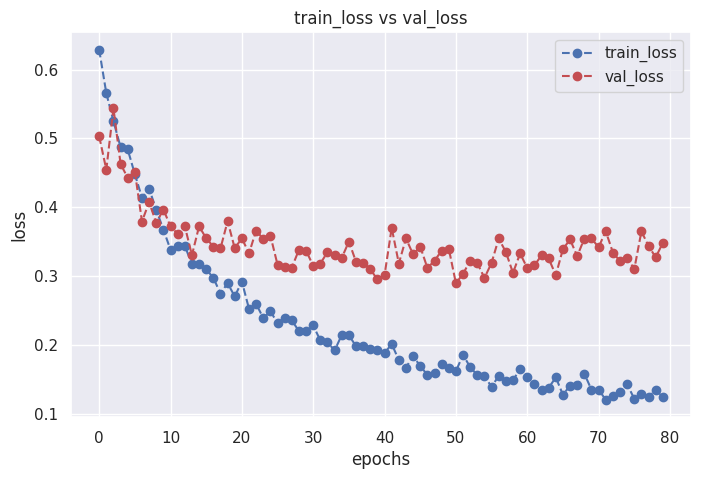

In [ ]:
## without weighted class
plot_results(history.loc[:79 ,'train_loss'], history.loc[:79,'val_loss'], plot_type = 'loss')

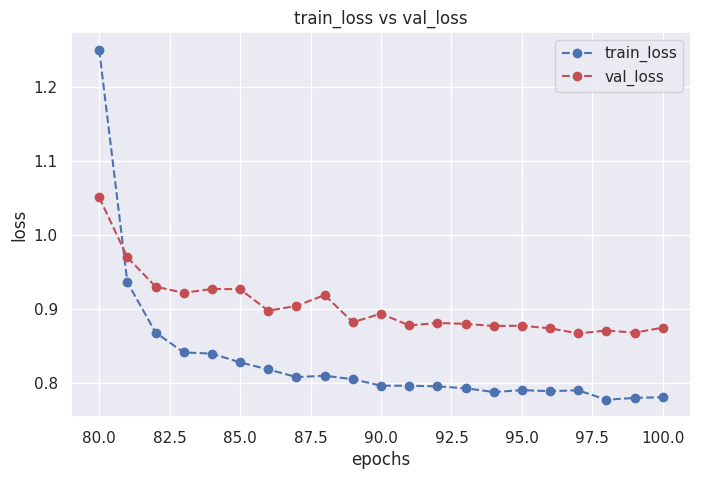

In [ ]:
## with weighted class
plot_results(history.loc[80: ,'train_loss'], history.loc[80:,'val_loss'], plot_type = 'loss')

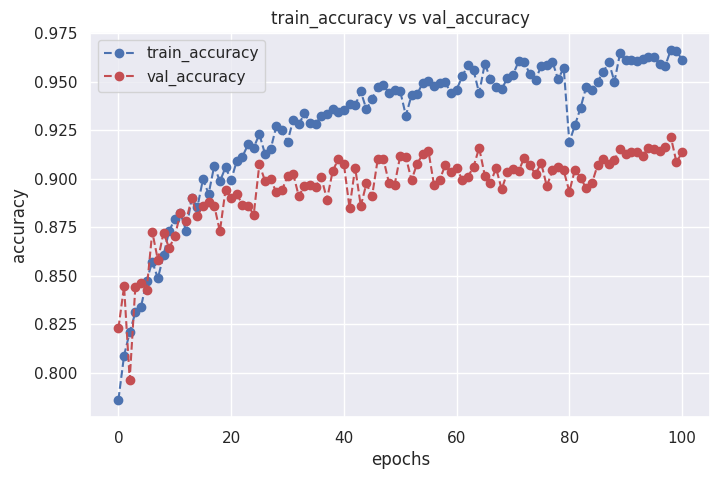

In [ ]:
plot_results(history.loc[ : ,'train_accuracy'], history.loc[ : ,'val_accuracy'], plot_type = 'accuracy')

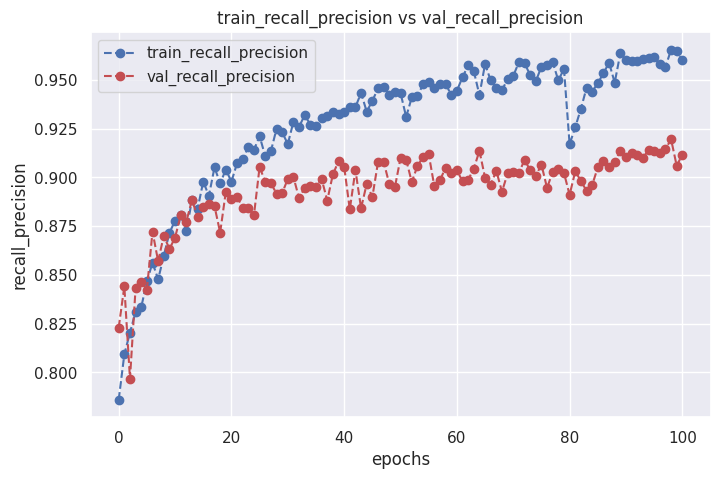

In [ ]:
plot_results(history.loc[ : ,'train_recall_precision'], history.loc[ : ,'val_recall_precision'], plot_type = 'recall_precision')

In [ ]:
preds_train, labels_train= preds_with_loaders(train_loader, model, cfg.model.device, cfg.model.classes)

In [ ]:
calc_precision_recall_cls(preds_train, labels_train, cfg.model.classes)

 classes         precision       recall     f1_score 

 Amanita              1.00         1.00         1.00
 Boletus              1.00         1.00         1.00
 Cortinarius          1.00         1.00         1.00
 Hygrocybe            1.00         1.00         1.00
 Entoloma             1.00         1.00         1.00
 Russula              1.00         1.00         1.00
 Suillus              0.99         1.00         1.00
 Agaricus             1.00         1.00         1.00
 Lactarius            1.00         1.00         1.00


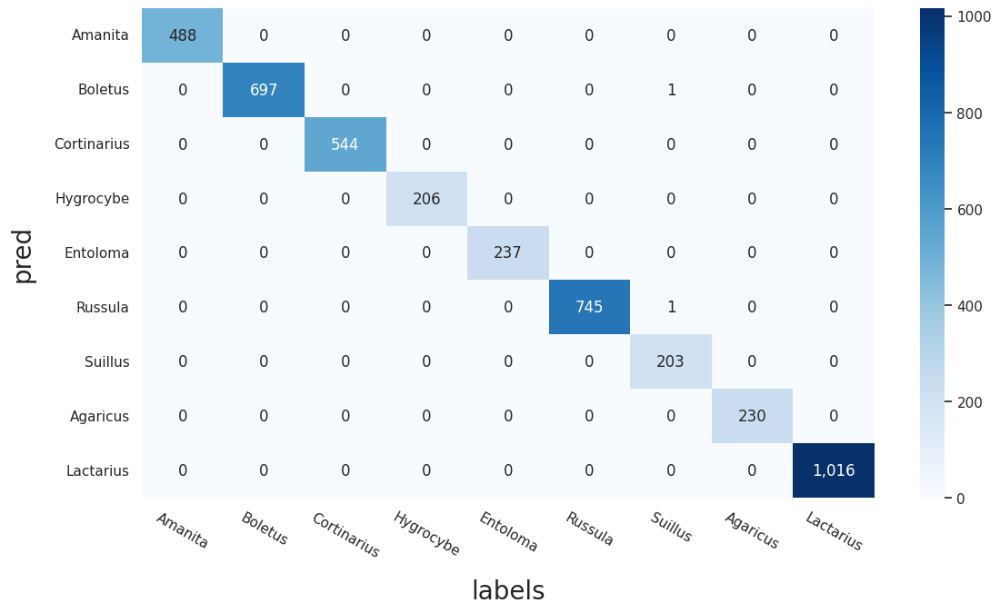

In [ ]:
plot_confusion_matrix(preds_train, labels_train, cfg.model.classes)

In [ ]:
preds_val, labels_val= preds_with_loaders(val_loader, model, cfg.model.device, cfg.model.classes)

In [ ]:
calc_precision_recall_cls(preds_val, labels_val, cfg.model.classes)

 classes         precision       recall     f1_score 

 Amanita              0.92         0.91         0.91
 Boletus              0.94         0.99         0.96
 Cortinarius          0.87         0.88         0.87
 Hygrocybe            0.81         0.95         0.88
 Entoloma             0.88         0.90         0.89
 Russula              0.96         0.87         0.92
 Suillus              0.86         0.90         0.88
 Agaricus             0.82         0.91         0.86
 Lactarius            0.94         0.90         0.92


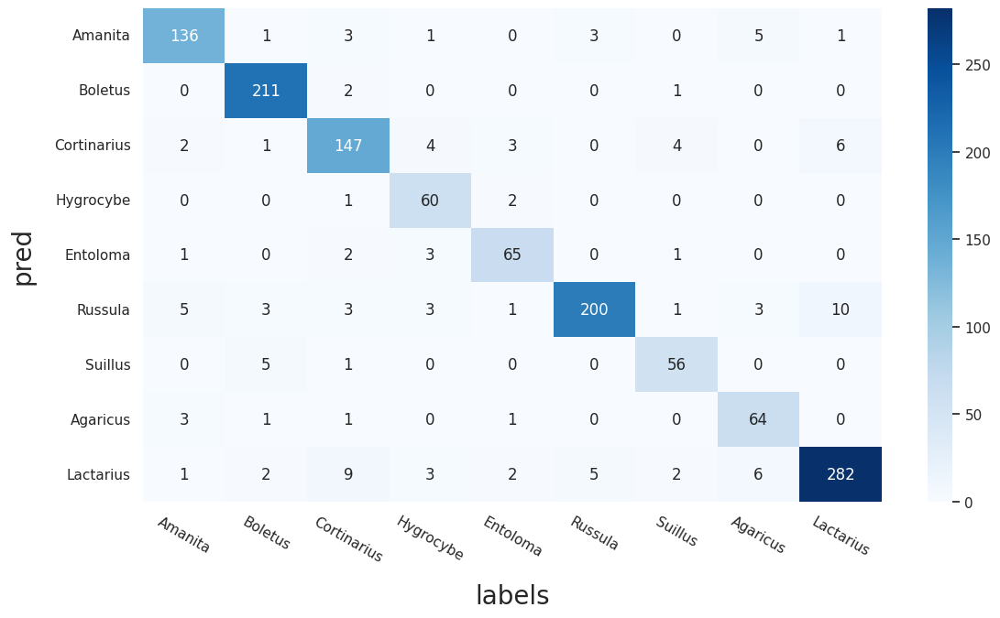

In [ ]:
plot_confusion_matrix(preds_val, labels_val, cfg.model.classes)

In [ ]:
preds_test, labels_test= preds_with_loaders(test_loader, model, cfg.model.device, cfg.model.classes)

In [ ]:
calc_precision_recall_cls(preds_test, labels_test, cfg.model.classes)

 classes         precision       recall     f1_score 

 Amanita              0.91         0.94         0.93
 Boletus              0.95         0.98         0.97
 Cortinarius          0.92         0.90         0.91
 Hygrocybe            0.94         0.98         0.96
 Entoloma             0.83         0.91         0.87
 Russula              0.97         0.87         0.91
 Suillus              0.79         0.96         0.86
 Agaricus             0.86         0.91         0.88
 Lactarius            0.93         0.91         0.92


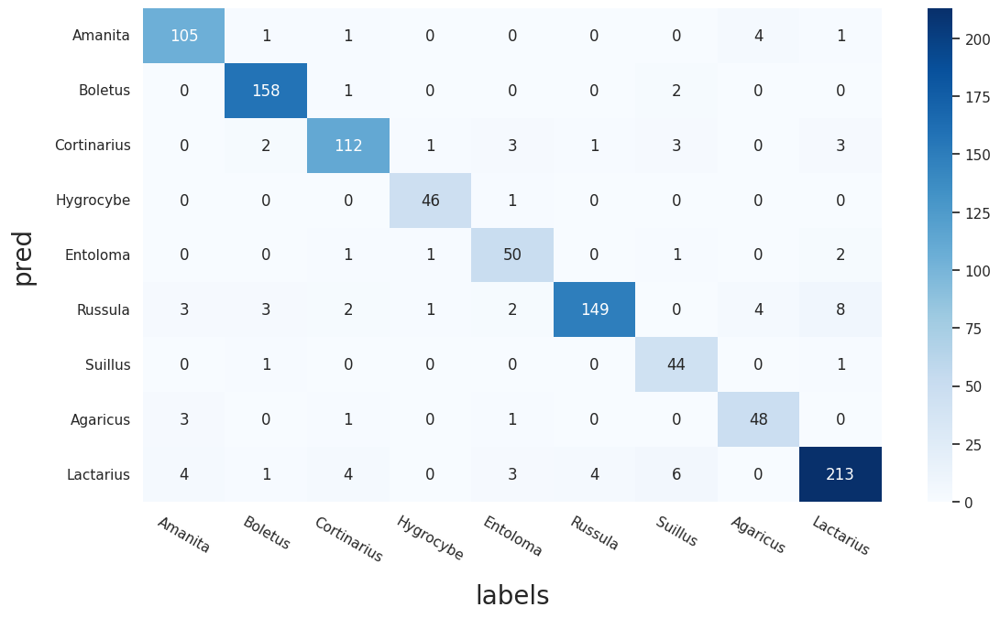

In [ ]:
plot_confusion_matrix(preds_test, labels_test, cfg.model.classes)

In [14]:
import torch

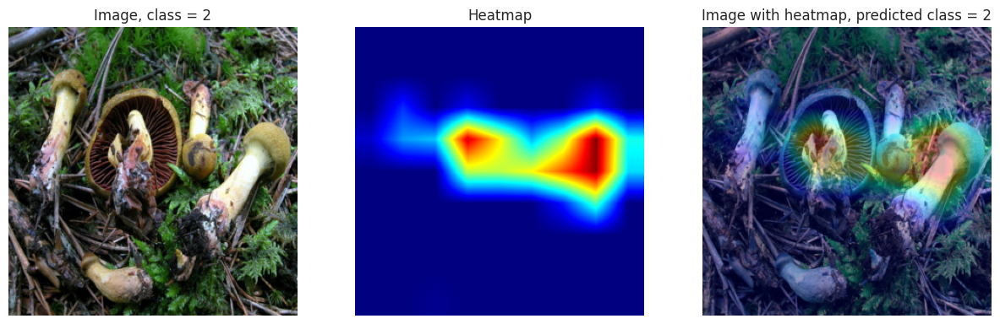

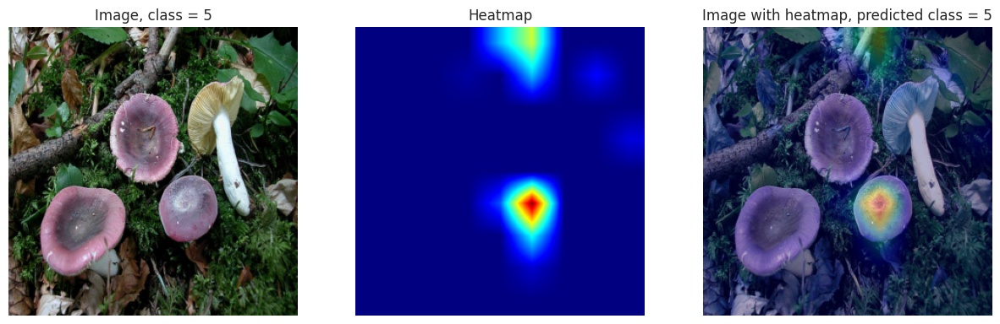

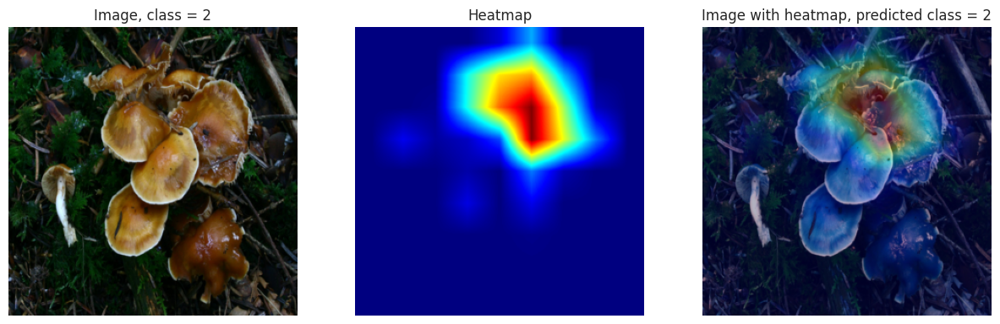

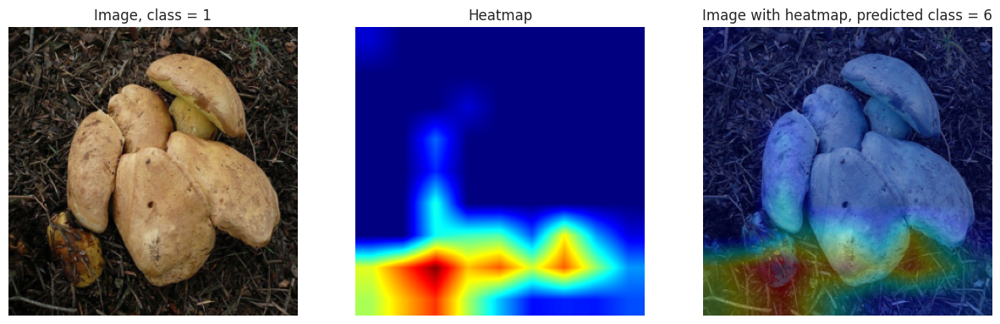

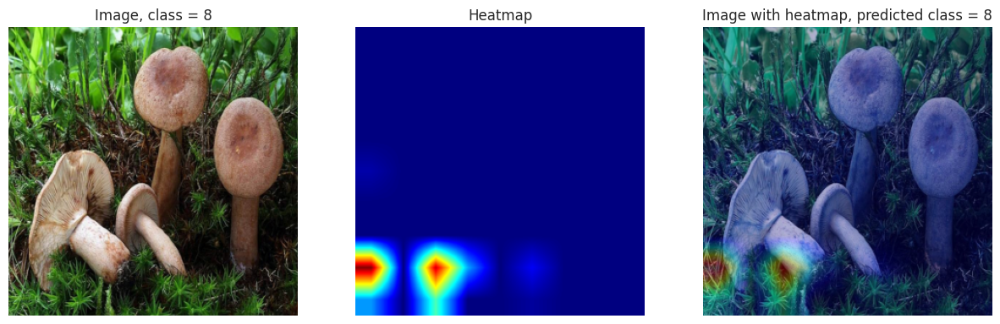

...

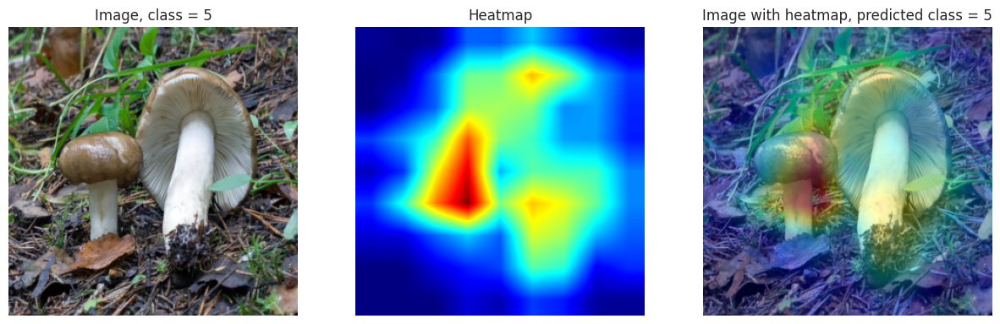

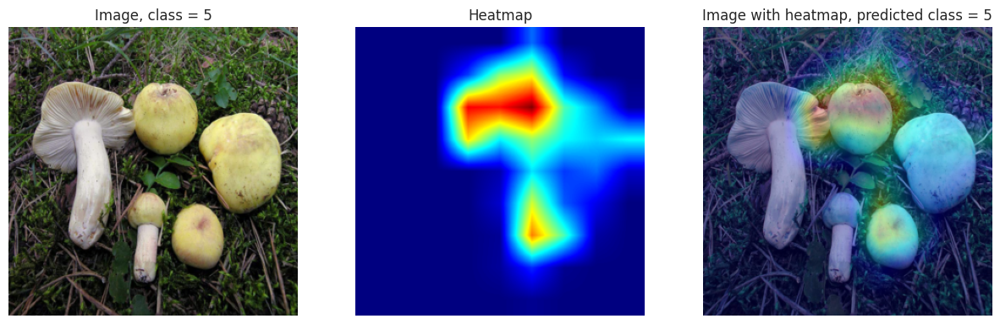

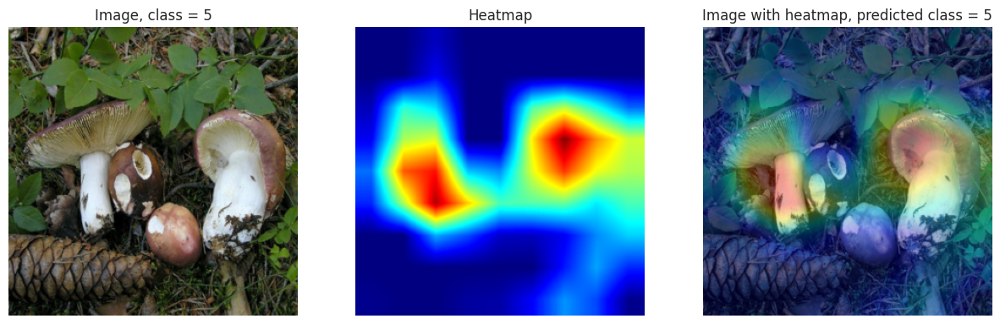

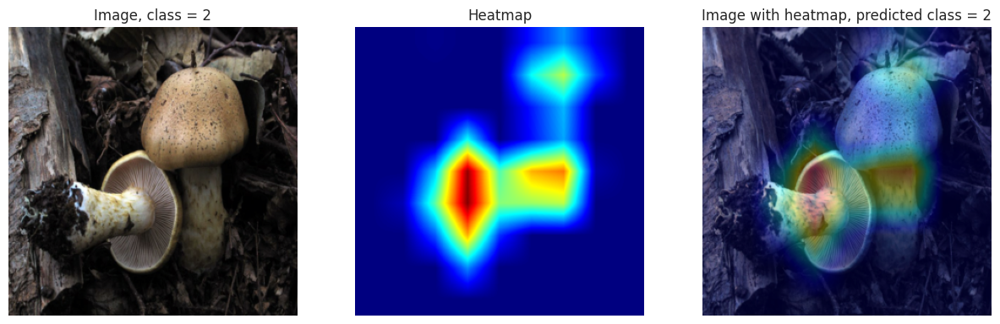

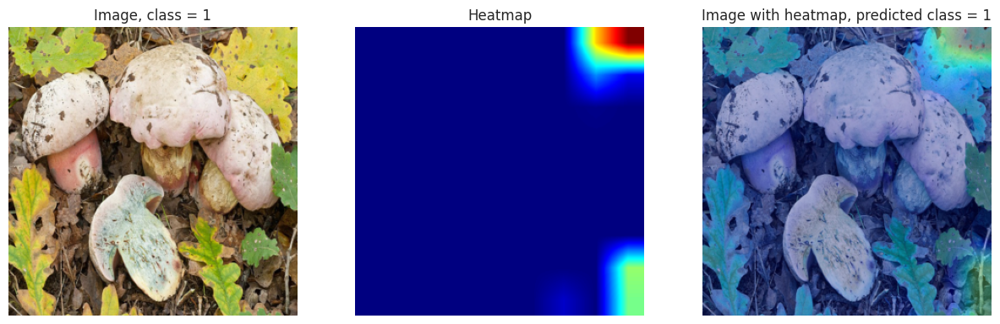

In [17]:
from  Grad_cam_utils import Generate_cam
imgs,labels = next(iter(test_loader))
for img, label in zip(imgs, labels):
  img, label = img.to(cfg.model.device), label.to(cfg.model.device)
  Generate_cam(img[None], grad_cam, label)
